# Imports

In [47]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt

pd.set_option('display.max_columns', None)

In [65]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE 

In [49]:
df_rfm = pd.read_csv("data/merged_datasets/rfm.csv", index_col="customer_unique_id")
df_complete = pd.read_csv("data/merged_datasets/complete_customer_info.csv", index_col="customer_unique_id")

# RFM

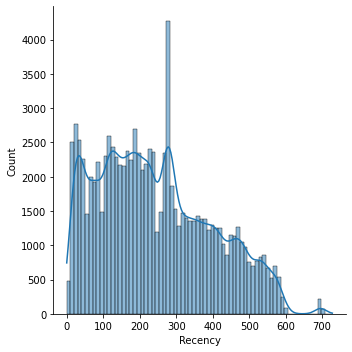

In [50]:
sns.displot(df_rfm["Recency"], kde=True)

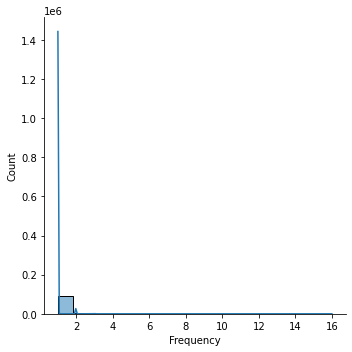

In [51]:
sns.displot(df_rfm["Frequency"], kde=True)


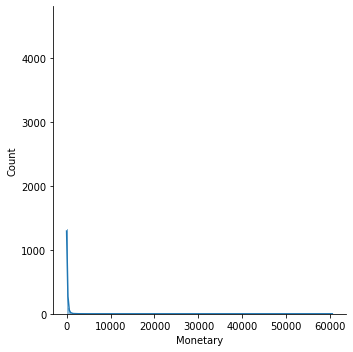

In [52]:
sns.displot(df_rfm["Monetary"], kde=True)

In [53]:
df_rfm

,Monetary,Recency,Frequency
customer_unique_id,,,
0000366f3b9a7992bf8c76cfdf3221e2,129.90,115,1
0000b849f77a49e4a4ce2b2a4ca5be3f,18.90,118,1
0000f46a3911fa3c0805444483337064,69.00,541,1
0000f6ccb0745a6a4b88665a16c9f078,25.99,325,1
0004aac84e0df4da2b147fca70cf8255,180.00,292,1
...,...,...,...
fffcf5a5ff07b0908bd4e2dbc735a684,2250.00,451,1
fffea47cd6d3cc0a88bd621562a9d061,64.89,266,1
ffff371b4d645b6ecea244b27531430a,89.90,572,1


In [104]:
scaled_data = StandardScaler().fit_transform(df_rfm)

<AxesSubplot:>

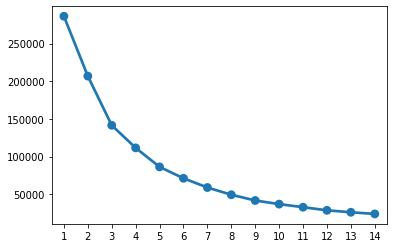

In [55]:
sum_of_sq_dist = {}
for k in range(1,15):
  km = KMeans(n_clusters=k, max_iter=1000).fit(scaled_data)
  sum_of_sq_dist[k] = km.inertia_
  
sns.pointplot(x=list(sum_of_sq_dist.keys()), y=list(sum_of_sq_dist.values()))

In [105]:
cluster = KMeans(n_clusters=3)
labels = cluster.fit_predict(scaled_data)

In [57]:
px.scatter_3d(df_rfm, x="Monetary", y="Recency", z="Frequency", color=labels).update_traces(marker_size=5).show()

In [101]:
raise
rfm_tsne = TSNE().fit_transform(X=scaled_data)

/Users/rom1/opt/anaconda3/envs/datascience/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/Users/rom1/opt/anaconda3/envs/datascience/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



In [107]:
px.scatter(x=rfm_tsne[:,0], y=rfm_tsne[:,1], color=labels, data_frame=df_rfm, hover_data=['Monetary', 'Recency', 'Frequency']).show()

# More complete KMeans

In [58]:
df_complete.columns

Index(['Monetary', 'Recency', 'Frequency', 'distance', 'deliver_time',
       'review_score'],
      dtype='object')

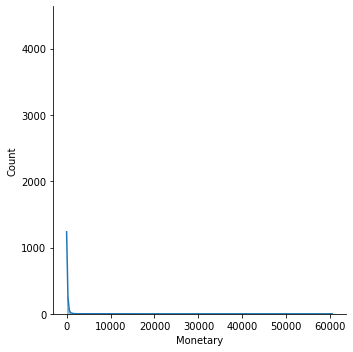

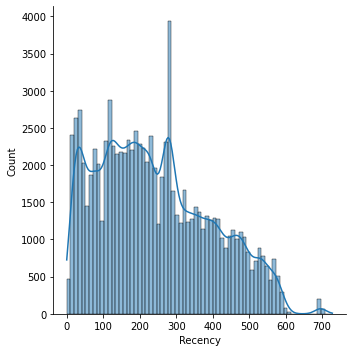

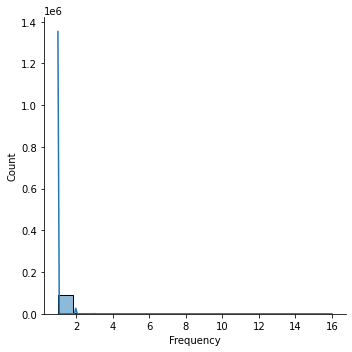

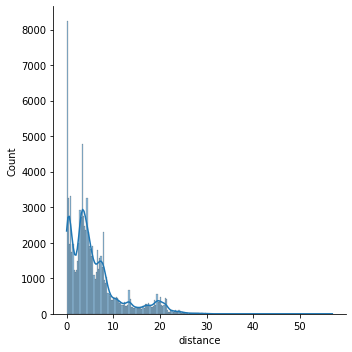

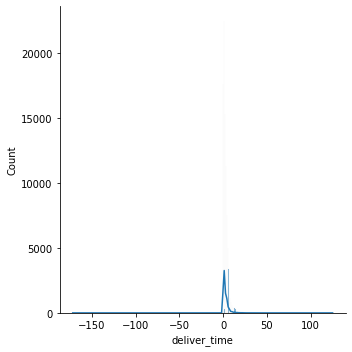

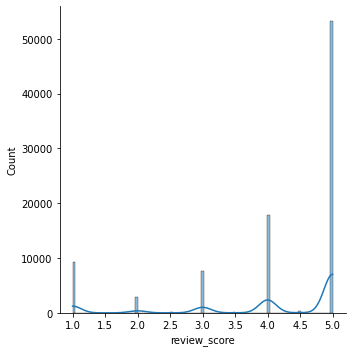

In [59]:
for column in df_complete.columns:
  sns.displot(df_complete[column], kde=True)

In [102]:
scaled_data = StandardScaler().fit_transform(df_complete)

<AxesSubplot:>

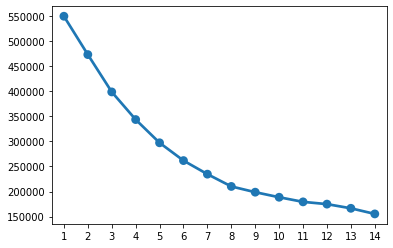

In [64]:
sum_of_sq_dist = {}
for k in range(1,15):
  km = KMeans(n_clusters=k).fit(scaled_data)
  sum_of_sq_dist[k] = km.inertia_
  
sns.pointplot(x=list(sum_of_sq_dist.keys()), y=list(sum_of_sq_dist.values()))

In [82]:
cluster = KMeans(n_clusters=8)
labels = cluster.fit_predict(scaled_data)

In [63]:
px.scatter_3d(df_complete, x="Monetary", y="Recency", z="Frequency", color=labels).update_traces(marker_size=5).show()

In [72]:
raise
tsned = TSNE().fit_transform(X=scaled_data)

/Users/rom1/opt/anaconda3/envs/datascience/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:780: FutureWarning:

The default initialization in TSNE will change from 'random' to 'pca' in 1.2.

/Users/rom1/opt/anaconda3/envs/datascience/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:790: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.



In [99]:
px.scatter(x=tsned[:,0], y=tsned[:,1], color=labels, data_frame=df_complete, hover_data=['Monetary', 'Recency', 'Frequency', 'distance', 'deliver_time', 'review_score']).show()

In [79]:
tsned[:,1]


array([38.382    , 32.292603 , 27.434046 , ...,  7.1825123, 21.853249 ,
       -4.1822333], dtype=float32)